<a href="https://colab.research.google.com/github/rageya/dog-vision/blob/main/Dog_Vision_Full_Model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Tools and Initiating Notebook

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
try:
  # %tensorflow_version only exists in Colab
  %tensorflow_version 2.x
except Exception:
  pass

Colab only includes TensorFlow 2.x; %tensorflow_version has no effect.


In [ ]:
#!unzip "/content/drive/MyDrive/DOG-VISION/dog-breed-identification.zip" -d "/content/drive/MyDrive/DOG-VISION/"

In [ ]:
import tensorflow as tf
import tensorflow_hub as hub

In [ ]:
print("GPU", "Available" if tf.config.list_physical_devices("GPU") else "Not Available")

GPU Available


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import sklearn

## Getting our data Ready (turning into tensors)

Our data has to be in numerical format.

In [ ]:
label_csv = pd.read_csv("/content/drive/MyDrive/DOG-VISION/labels.csv")
print(label_csv.describe())
print(label_csv.head())

                                      id               breed
count                              10222               10222
unique                             10222                 120
top     000bec180eb18c7604dcecc8fe0dba07  scottish_deerhound
freq                                   1                 126
                                 id             breed
0  000bec180eb18c7604dcecc8fe0dba07       boston_bull
1  001513dfcb2ffafc82cccf4d8bbaba97             dingo
2  001cdf01b096e06d78e9e5112d419397          pekinese
3  00214f311d5d2247d5dfe4fe24b2303d          bluetick
4  0021f9ceb3235effd7fcde7f7538ed62  golden_retriever


In [ ]:
label_csv.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


<Axes: xlabel='breed'>

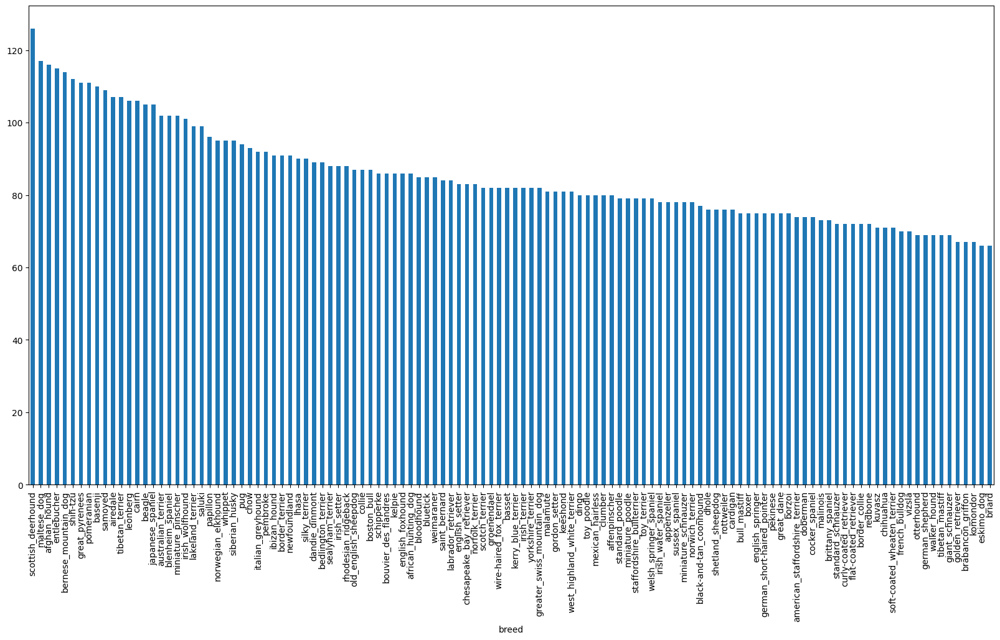

In [ ]:
# How many images are there of each breed
label_csv.breed.value_counts().plot.bar(figsize=(20,10))

In [ ]:
label_csv.breed.value_counts().median()

82.0

In [ ]:
from IPython.display import Image
#Image("/content/drive/MyDrive/DOG-VISION/train/0a0c223352985ec154fd604d7ddceabd.jpg")

## Getting images and their labels

List of images and their pathnames

In [ ]:
label_csv.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


In [ ]:
# Create pathnames from Images ID's

filenames = ["drive/MyDrive/DOG-VISION/train/" + fname + ".jpg" for fname in label_csv['id']]

filenames[:10]

['drive/MyDrive/DOG-VISION/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/MyDrive/DOG-VISION/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/MyDrive/DOG-VISION/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/MyDrive/DOG-VISION/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/MyDrive/DOG-VISION/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 'drive/MyDrive/DOG-VISION/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 'drive/MyDrive/DOG-VISION/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 'drive/MyDrive/DOG-VISION/train/002a283a315af96eaea0e28e7163b21b.jpg',
 'drive/MyDrive/DOG-VISION/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 'drive/MyDrive/DOG-VISION/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

In [ ]:
# Checking whether number of filenames matches with number of actual image files

import os
if len(os.listdir("drive/MyDrive/DOG-VISION/train/")) == len(filenames):
  print("Matches to actual data")
else:
  print("Does not matches to actual data")

Matches to actual data


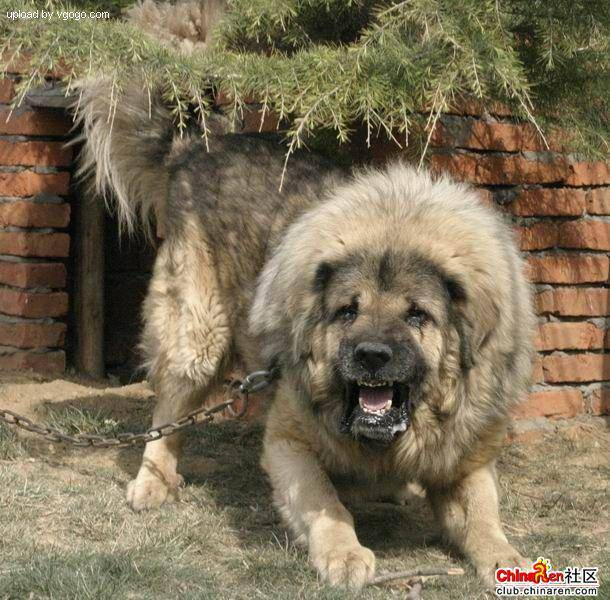

In [ ]:
Image(filenames[9000])

In [ ]:
import numpy as np

labels = label_csv['breed'].to_numpy() #convert labels coloumn to numpy Array
labels[:10]

array(['boston_bull', 'dingo', 'pekinese', 'bluetick', 'golden_retriever',
       'bedlington_terrier', 'bedlington_terrier', 'borzoi', 'basenji',
       'scottish_deerhound'], dtype=object)

In [ ]:
# See if number of labels matches the number of filenames
if len(labels) == len(filenames):
  print("Number of labels matches number of filenames!")
else:
  print("Number of labels does not match number of filenames, check data directories.")

Number of labels matches number of filenames!


In [ ]:
# Finding unique values

unique_breeds = np.unique(labels)
len(unique_breeds)

120

In [ ]:
# Turn a single label into a array of booleans
print(labels[0])
labels[0] == unique_breeds

boston_bull


array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

In [ ]:
# Turn every label into a boolean array

boolean_labels = [label == unique_breeds for label in labels]
boolean_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [ ]:
print(len(boolean_labels))

10222


In [ ]:
# Turning boolean arrays into integers
print(labels[0]) #original label
print(np.where(unique_breeds == labels[0])) #index where labels occurs
print(boolean_labels[0].argmax()) #index where label occurs in boolean_labels
print(boolean_labels[0].astype(int)) # there will be 1 where actual label occurs

boston_bull
(array([19]),)
19
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


## Creating our own Validation Set

In [ ]:
# Setup X & y variables
X = filenames

y = boolean_labels

In [ ]:
len(filenames) == len(boolean_labels)

True

### Starting off with 1000 images and increasing as we progress through

In [ ]:
# Set a number of 1000 images to use for experimenting
NUM_IMAGES = 1000 #@param {type:"slider", min:1000, max:10000, step:100}
NUM_IMAGES

1000

In [ ]:
# Lets split our data into train and validation set
from sklearn.model_selection import train_test_split

# Split them into training and validation of total size NUM_IMAGES

X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMAGES],
                                                  y[:NUM_IMAGES],
                                                  test_size= 0.2,
                                                  random_state = 42)

len(X_train), len(X_val), len(y_train), len(y_val)

(800, 200, 800, 200)

In [ ]:
X_train[:5], y_train[:2]

(['drive/MyDrive/DOG-VISION/train/00bee065dcec471f26394855c5c2f3de.jpg',
  'drive/MyDrive/DOG-VISION/train/0d2f9e12a2611d911d91a339074c8154.jpg',
  'drive/MyDrive/DOG-VISION/train/1108e48ce3e2d7d7fb527ae6e40ab486.jpg',
  'drive/MyDrive/DOG-VISION/train/0dc3196b4213a2733d7f4bdcd41699d3.jpg',
  'drive/MyDrive/DOG-VISION/train/146fbfac6b5b1f0de83a5d0c1b473377.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False,  True,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, 

## Preprocessing Images (turning images into tensors)

To preprocess our images into Tensors we're going to write a function which does a few things:

1. Takes an image filename as input.
2. Uses TensorFlow to read the file and save it to a variable, image.
3. Turn our image (a jpeg file) into Tensors.
4. Normalize our image (convert color channel values from 0-255 to 0-1)
5. Resize the image to be of shape (224, 224).
6. Return the modified image.

In [ ]:
# Convert Image into Numpy Array
from matplotlib.pyplot import imread
image = imread(filenames[42])
image.shape

(257, 350, 3)

array([[[ 89, 137,  89],
        [ 76, 124,  76],
        [ 63, 111,  61],
        ...,
        [ 77, 133,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  75],
        [ 67, 114,  68],
        [ 63, 110,  64],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 132,  84]],

       [[ 56, 104,  66],
        [ 58, 106,  68],
        [ 64, 112,  74],
        ...,
        [ 71, 127,  82],
        [ 73, 129,  84],
        [ 74, 130,  85]],

       ...,

       [[  2,  11,  10],
        [  5,  14,  11],
        [  8,  14,  14],
        ...,
        [120, 113,  67],
        [126, 118,  71],
        [122, 114,  67]],

       [[  0,   3,   7],
        [  2,   7,  10],
        [  3,   9,   7],
        ...,
        [105,  98,  54],
        [112, 104,  58],
        [111, 103,  57]],

       [[ 16,  18,  30],
        [ 16,  19,  24],
        [ 15,  20,  14],
        ...,
        [101,  92,  51],
        [ 97,  88,  47],
        [120, 111,  70]]], dtype=uint8)
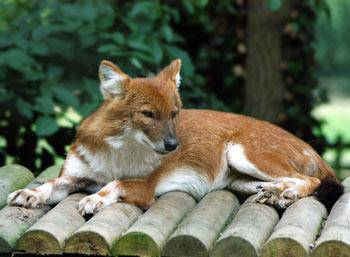

In [ ]:
image #click on 'show data' for viewing the array

In [ ]:
image.max(), image.min()

(255, 0)

In [ ]:
image[:2]

array([[[ 89, 137,  89],
        [ 76, 124,  76],
        [ 63, 111,  61],
        ...,
        [ 77, 133,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  75],
        [ 67, 114,  68],
        [ 63, 110,  64],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 132,  84]]], dtype=uint8)

In [ ]:
# Turning into tensor

tf.constant(image)[:2]

<tf.Tensor: shape=(2, 350, 3), dtype=uint8, numpy=
array([[[ 89, 137,  89],
        [ 76, 124,  76],
        [ 63, 111,  61],
        ...,
        [ 77, 133,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  75],
        [ 67, 114,  68],
        [ 63, 110,  64],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 132,  84]]], dtype=uint8)>

In [ ]:
# Define image size
IMG_SIZE = 224

def process_image(image_path):
  # Read in image file
  image = tf.io.read_file(image_path)
  # Turn the image into numerical Tensor with 3 colour channels (RGB)
  image = tf.image.decode_jpeg(image, channels=3)
  # Convert the colour channel values from 0-225 values to 0-1 values
  image = tf.image.convert_image_dtype(image, tf.float32)
  # Resize the image (224, 244)
  image = tf.image.resize(image, size=[IMG_SIZE, IMG_SIZE])
  return image

## Turning our data into Batches

Large amount of data may not fit to the model directly in one go

Therefore we divide all of our data into smaller batches, default = 32

In [ ]:
# Create a simple function to return a tuple
def get_image_label(image_path, label):
  image = process_image(image_path)
  return image, label

In [ ]:
(process_image(X[42]), tf.constant(y[42]))

(<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
 array([[[0.3264178 , 0.5222886 , 0.3232816 ],
         [0.2537167 , 0.44366494, 0.24117757],
         [0.25699762, 0.4467087 , 0.23893751],
         ...,
         [0.29325107, 0.5189916 , 0.3215547 ],
         [0.29721776, 0.52466875, 0.33030328],
         [0.2948505 , 0.5223015 , 0.33406618]],
 
        [[0.25903144, 0.4537807 , 0.27294815],
         [0.24375686, 0.4407019 , 0.2554778 ],
         [0.2838985 , 0.47213382, 0.28298813],
         ...,
         [0.2785345 , 0.5027992 , 0.31004712],
         [0.28428748, 0.5108719 , 0.32523635],
         [0.28821915, 0.5148036 , 0.32916805]],
 
        [[0.20941195, 0.40692952, 0.25792548],
         [0.24045378, 0.43900946, 0.2868911 ],
         [0.29001117, 0.47937486, 0.32247734],
         ...,
         [0.26074055, 0.48414773, 0.30125174],
         [0.27101526, 0.49454468, 0.32096273],
         [0.27939945, 0.5029289 , 0.32934693]],
 
        ...,
 
        [[0.00634795, 0.03442048

In [ ]:
# Define the batch size
BATCH_SIZE = 32

def create_data_batches(x, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):
  # Test data do not have labels most of the time..
  if test_data:
    print("Creating test data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x)))
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch

  # If the data if a valid dataset, we don't need to shuffle it
  elif valid_data:
    print("Creating validation data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), # filepaths
                                               tf.constant(y))) # labels
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

  else:
    # Training data needs to be shuffled
    print("Creating training data batches...")
    # Turn filepaths and labels into Tensors
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), # filepaths
                                              tf.constant(y))) # labels

    # Shuffling pathnames and labels before mapping
    data = data.shuffle(buffer_size=len(x))

    # Create (image, label) tuples
    data = data.map(get_image_label)

    # Turn the data into batches
    data_batch = data.batch(BATCH_SIZE)
  return data_batch

In [ ]:
# Creating training and validation data batches

train_data = create_data_batches(X_train, y_train)

val_data = create_data_batches(X_val, y_val, valid_data=True)

Creating training data batches...
Creating validation data batches...


In [ ]:
# Checking out different attributes of our data batches

train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

## Visualising Data Branches

Visualing the above written code..

In [ ]:
import matplotlib.pyplot as plt

# Create a function to visualise data branches
def show_25_images(image, labels):
  #Displays a plot of 25 image and labels from a databatch
  plt.figure(figsize=(20,10))
  #Loop through 25
  for i in range(25):
    # Create subplots (5 rows, 5 coloumns)
    ax = plt.subplot(5, 5, i+1)
    #Display an image
    plt.imshow(image[i])
    # Add the image label as the title
    plt.title(unique_breeds[labels[i].argmax()])
    # Turn grid lines off
    plt.axis('off')

In [ ]:
train_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

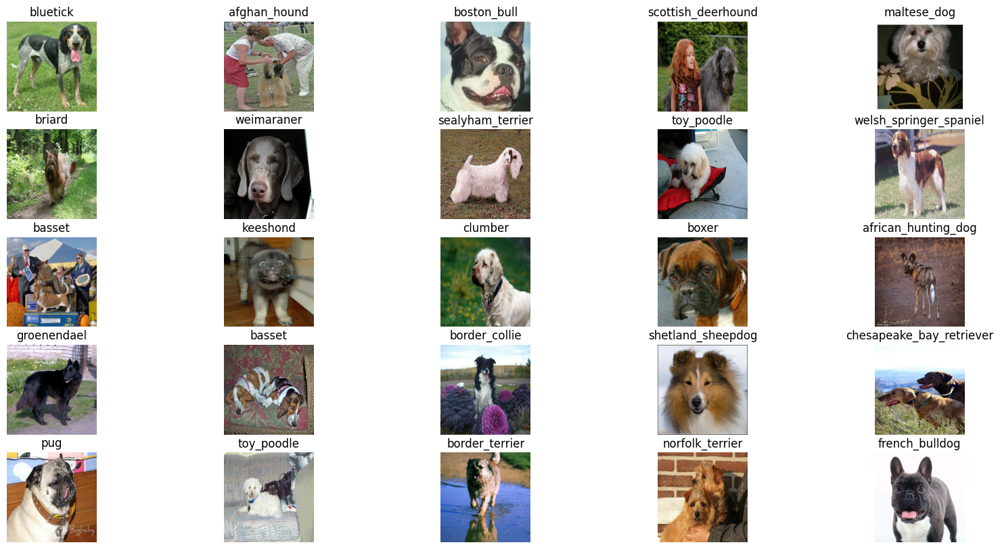

In [ ]:
train_images, train_labels = next(train_data.as_numpy_iterator())
show_25_images(train_images, train_labels)

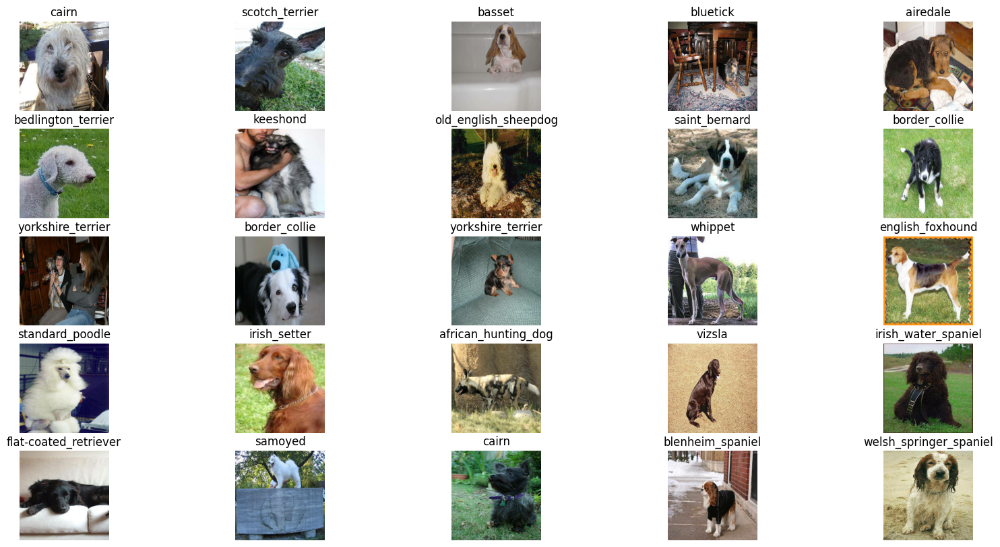

In [ ]:
# Visualising validation set
val_images, val_labels = next(val_data.as_numpy_iterator())
show_25_images(val_images, val_labels)

## Building A Model

### Preparing Our Input and Outputs..

In [ ]:
import tf_keras

# Setup input shape to the model
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3] # batch, height, width, colour channels

# Setup output shape of the model
OUTPUT_SHAPE = len(unique_breeds) # number of unique labels

# Setup model URL from TensorFlow Hub (Now at Kaggle)
MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4"

### Putting Together in `Keras` Deep Learning Model!

1. Create a function which takes the input shape, output shape and the model we have chosen as parameters
2. Defines the layers in a keras model in a subsequential fashion
3. Compiles the model
4. Builds the model
5. Returns the model

In [ ]:
# Create a function which builds a Keras model
def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MODEL_URL):
  print("Building model with:", MODEL_URL)

  # Setup the model layers
  model = tf_keras.Sequential([
    hub.KerasLayer(MODEL_URL), # Layer 1 (input layer)
    tf_keras.layers.Dense(units=OUTPUT_SHAPE,
                          activation="softmax") # Layer 2 (output layer)
  ])

  # Compile the model
  model.compile(
      loss=tf_keras.losses.CategoricalCrossentropy(), # Our model wants to reduce this (how wrong its guesses are)
      optimizer=tf_keras.optimizers.Adam(), # A friend telling our model how to improve its guesses
      metrics=["accuracy"] # We'd like this to go up
  )

  # Build the model
  model.build(INPUT_SHAPE) # Let the model know what kind of inputs it'll be getting

  return model

In [ ]:
# Create a model and check its details
model = create_model()
model.summary()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer_10 (KerasLayer  (None, 1001)              5432713   
 )                                                               
                                                                 
 dense (Dense)               (None, 120)               120240    
                                                                 
Total params: 5552953 (21.18 MB)
Trainable params: 120240 (469.69 KB)
Non-trainable params: 5432713 (20.72 MB)
_________________________________________________________________


### Creating Callbacks

Callbacks are helper function

Will create 2 callbacks

One for TensorBoard

Second for early stopping to prevent our model from training for too long

In [ ]:
## TensorBoard callback

# Load TensorBoard notebook extension

%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
import datetime

# create a function to build a tensorboard callback
def create_tensorboard_callback():
  # create a log directory for storing the logs
  logdir = os.path.join("drive/MyDrive/DOG-VISION/logs",
                        datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

  return tf_keras.callbacks.TensorBoard(logdir)

In [ ]:
## Early Stopping Callback

early_stopping = tf_keras.callbacks.EarlyStopping(monitor = "val_accuracy",
                                                  patience = 3)

## Training Our Model(On subset of data)..

In [ ]:
NUM_EPOCHS = 100 #@param {type:'slider', min : 10, max : 100, step : 10}

'''
How many rounds we want our model to look through the data : EPOCHS
'''

'\nHow many rounds we want our model to look through the data : EPOCHS\n'

In [ ]:
# Create a function which trains the model using `create_model`
# Setup TensorBoard callback
# Call the fit function on our model, passing the training data. validation data, number of epochs(rounds) , callbacks (helper function)
# Return the model


In [ ]:
# Build a function to train and return the trained model
def train_model():

  # Create a model
  model = create_model()

  # create a new TensorBoard session everytime we train the model
  tensorboard = create_tensorboard_callback()

  # Fit the model to the data, passing it the callback we created.
  model.fit(x = train_data,
            epochs = NUM_EPOCHS,
            validation_data = val_data,
            validation_freq = 1,
            callbacks = [tensorboard, early_stopping])

  # Return the model
  return model

In [ ]:
# Fit the model to the data
model = train_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Epoch 1/100
25/25 [==============================] - 169s 7s/step - loss: 4.6378 - accuracy: 0.0838 - val_loss: 3.5300 - val_accuracy: 0.2150
Epoch 2/100
25/25 [==============================] - 4s 171ms/step - loss: 1.6805 - accuracy: 0.6750 - val_loss: 2.2798 - val_accuracy: 0.4650
Epoch 3/100
25/25 [==============================] - 4s 179ms/step - loss: 0.5818 - accuracy: 0.9262 - val_loss: 1.7246 - val_accuracy: 0.5650
Epoch 4/100
25/25 [==============================] - 4s 157ms/step - loss: 0.2573 - accuracy: 0.9912 - val_loss: 1.5490 - val_accuracy: 0.5850
Epoch 5/100
25/25 [==============================] - 4s 173ms/step - loss: 0.1512 - accuracy: 0.9975 - val_loss: 1.4519 - val_accuracy: 0.6250
Epoch 6/100
25/25 [==============================] - 5s 184ms/step - loss: 0.1016 - accuracy: 0.9987 - val_loss: 1.4077 - val_accuracy: 0.6200
Epoch 7/100
25/25 [==============================]

In [ ]:
## Checking the TensorBoard logs

%tensorboard --logdir drive/MyDrive/DOG-VISION/logs

<IPython.core.display.Javascript object>

## Making and evaluating predictions using a trained model..

In [ ]:
# Make predictions on the validation data..
predictions = model.predict(val_data, verbose = 1)
predictions

7/7 [==============================] - 2s 164ms/step


array([[5.2372681e-04, 9.4594623e-05, 3.4752177e-04, ..., 3.8483887e-04,
        1.7250472e-05, 1.0369280e-02],
       [1.8861082e-03, 3.2309475e-04, 9.1357224e-02, ..., 1.7761546e-03,
        2.6166108e-03, 1.9713644e-04],
       [7.8796205e-05, 4.1669578e-04, 7.5231255e-05, ..., 7.0747337e-05,
        2.8199212e-05, 1.5699365e-03],
       ...,
       [1.8356584e-06, 8.2383440e-06, 1.7270270e-04, ..., 4.4029086e-05,
        6.4339663e-05, 2.8044302e-05],
       [1.8266118e-03, 3.2452459e-05, 9.7050317e-05, ..., 1.5215538e-04,
        7.1698545e-05, 7.0211496e-03],
       [2.9719126e-04, 1.7833909e-04, 1.8487101e-03, ..., 4.1964659e-04,
        5.3949578e-04, 1.3221210e-04]], dtype=float32)

In [ ]:
predictions.shape

(200, 120)

In [ ]:
np.sum(predictions[0])

1.0

In [ ]:
# Evaluating first prediction
index = 17
print(predictions[0])
print(f"Max value (probability of prediction): {np.max(predictions[index])}")
print(f"Sum: {np.sum(predictions[index])}")
print(f"Max index: {np.argmax(predictions[index])}")
print(f"Predicted label: {unique_breeds[np.argmax(predictions[index])]}")

[5.23726805e-04 9.45946231e-05 3.47521767e-04 1.40563352e-05
 1.82726464e-04 2.06616132e-05 7.50932051e-03 5.63827227e-04
 1.08559958e-04 3.06273461e-04 1.97990696e-04 8.58105341e-05
 6.61545026e-04 4.98274785e-05 5.64763577e-05 3.12863442e-04
 6.11585783e-05 1.30238920e-01 4.99869238e-05 3.41778614e-05
 2.85064569e-04 1.55639464e-05 3.06416177e-06 1.13287149e-03
 2.04755579e-05 7.78779431e-05 3.76790732e-01 7.44915815e-05
 1.09813770e-03 3.23916029e-04 4.23329839e-05 2.41274276e-04
 2.77102867e-04 2.47131757e-05 4.40261392e-05 2.44568493e-02
 3.66602580e-05 6.04911882e-04 9.39137317e-05 1.00743579e-04
 1.21286034e-03 3.30457042e-05 6.59904836e-05 8.29160490e-05
 7.37837108e-05 3.93533992e-04 7.45584694e-05 8.65648326e-05
 2.26201868e-04 1.49807456e-04 3.62294559e-05 5.83029650e-05
 4.00113786e-04 1.42785348e-05 9.21964893e-05 1.01335900e-04
 1.92200750e-04 3.25471861e-03 1.18766671e-04 1.09907277e-01
 3.02839966e-04 1.34054235e-05 7.43117591e-04 4.54622896e-05
 1.00701123e-04 3.227408

In [ ]:
# Turn probabilities into their respective labels..
def get_pred_label(prediction_probabilities):
  return unique_breeds[np.argmax(prediction_probabilities)]

pred_label = get_pred_label(predictions[9])
pred_label

'collie'

In [ ]:
# Create a function to unbatch a BatchDataset...

def unbatchify(data):

  images = []
  labels = []

  # Loop through unbathed data
  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breeds[np.argmax(label)])

  return images, labels

val_images, val_labels = unbatchify(val_data)
val_images[0], val_labels[0]

(array([[[0.29599646, 0.43284872, 0.3056691 ],
         [0.26635826, 0.32996926, 0.22846507],
         [0.31428418, 0.27701408, 0.22934894],
         ...,
         [0.77614343, 0.82320225, 0.8101595 ],
         [0.81291157, 0.8285351 , 0.8406944 ],
         [0.8209297 , 0.8263737 , 0.8423668 ]],
 
        [[0.2344871 , 0.31603682, 0.19543913],
         [0.3414841 , 0.36560842, 0.27241898],
         [0.45016077, 0.40117094, 0.33964607],
         ...,
         [0.7663987 , 0.8134138 , 0.81350833],
         [0.7304248 , 0.75012016, 0.76590735],
         [0.74518913, 0.76002574, 0.7830809 ]],
 
        [[0.30157745, 0.3082587 , 0.21018331],
         [0.2905954 , 0.27066195, 0.18401104],
         [0.4138316 , 0.36170745, 0.2964005 ],
         ...,
         [0.79871625, 0.8418535 , 0.8606443 ],
         [0.7957738 , 0.82859945, 0.8605655 ],
         [0.75181633, 0.77904975, 0.8155256 ]],
 
        ...,
 
        [[0.9746779 , 0.9878955 , 0.9342279 ],
         [0.99153054, 0.99772066, 0.94278

### Visualising Predictions..


In [ ]:
def plot_pred(prediction_probabilities, labels, images, n = 1):
  # View the prediction and the true value and image for sample n

  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]

  #Get the pred label
  pred_label = get_pred_label(pred_prob)

  # Plot and remove ticks
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  # Change the color according to the predicted value whether it is right or wrong

  if pred_label == true_label:
    color = "green"
  else:
    color = "red"

  # Change plot title to be predicted, probability and truth labe;
  plt.title("{} {:2.0f}% ({})".format(pred_label,
                                    np.max(pred_prob)*100,
                                    true_label),
                                    color = color)

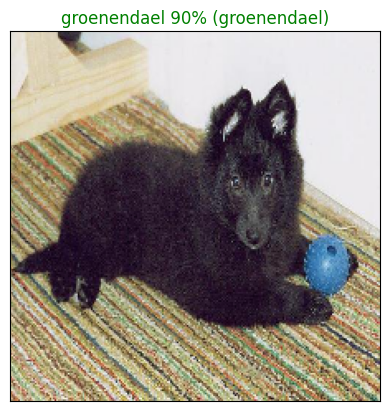

In [ ]:
plot_pred(prediction_probabilities=predictions,
          labels = val_labels,
          images = val_images,
          n = 77)

In [ ]:
def plot_pred_conf(prediction_probabilities, labels, n = 1):

  pred_prob, true_label = prediction_probabilities[n], labels[n]

  # Get the predicted label
  pred_label = get_pred_label(pred_prob)

  # Find the top 10 predictions confidence indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  # Find the top 10 prediction confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  # Find the top 10 prediction labels
  top_10_pred_labels = unique_breeds[top_10_pred_indexes]

  # Setup plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)),
                     top_10_pred_values,
                     color = 'grey')
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels = top_10_pred_labels,
             rotation = 'vertical')

  # Change the color of the true label
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color('green')
  else:
    pass

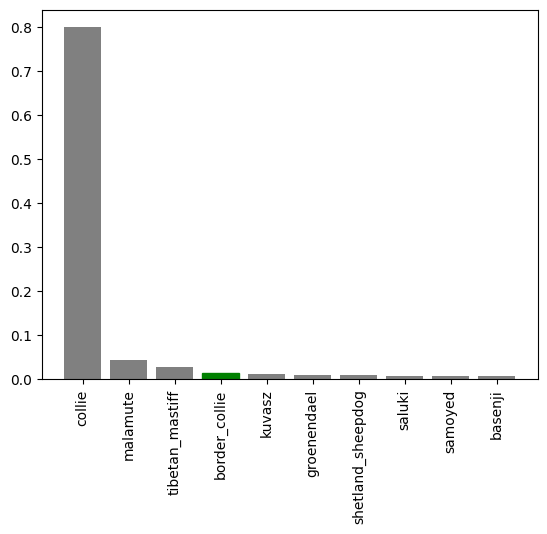

In [ ]:
plot_pred_conf(prediction_probabilities=predictions,
               labels=val_labels,
               n=9)

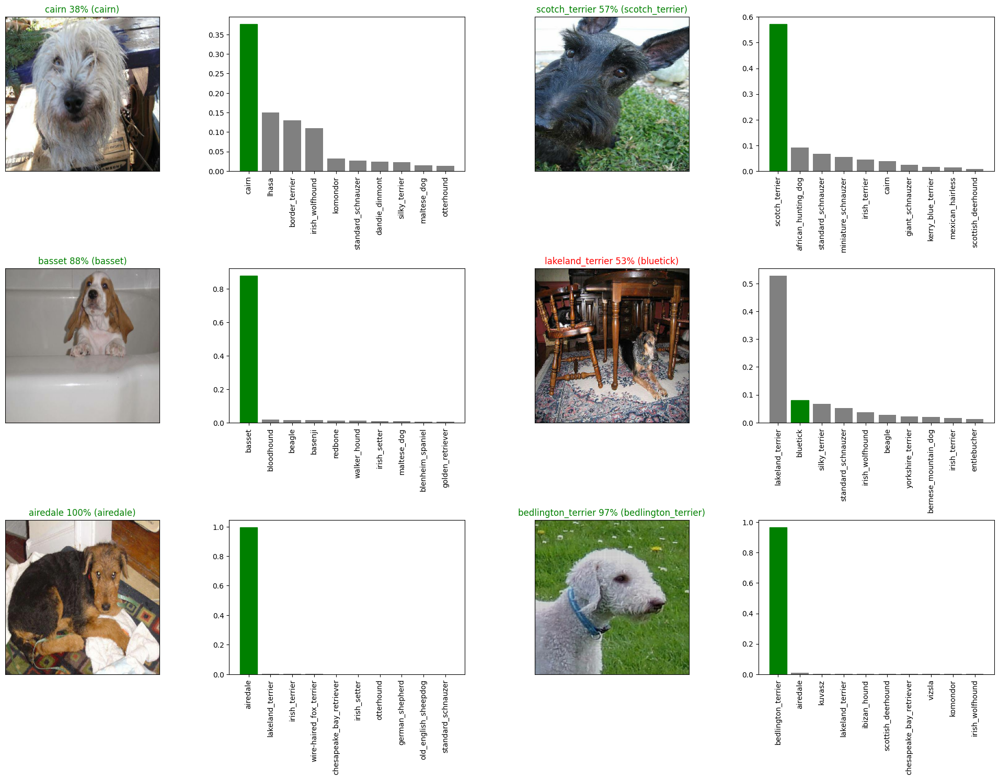

In [ ]:
# Let's check a few predictions and their different values
i_multiplier = 0
num_rows = 3
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize=(5*2*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                labels=val_labels,
                n=i+i_multiplier)
plt.tight_layout(h_pad=1.0)
plt.show()

## Save and Load Model

In [ ]:
# create a function to save a model

def save_model(model, suffix=None):

  modeldir = os.path.join("drive/MyDrive/DOG-VISION/models",
                          datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

  model_path = modeldir + "_" + suffix + ".h5" # Save format of the model
  print(f"Saving model to: {model_path}...")
  model.save(model_path)

  return model_path

In [ ]:
# Create a function to load a trained model
import tensorflow_hub as hub

def load_model(model_path):

  print(f"Loading saved model from {model_path}...")
  model = tf_keras.models.load_model(model_path,
                                     custom_objects = {"KerasLayer" : hub.KerasLayer}) # Make sure this is the correct name and import

  return model

In [ ]:
# Save our model trained on 1000 images
save_model(model, suffix="1000-images-mobilenetv2-Adam")

Saving model to: drive/MyDrive/DOG-VISION/models/20240813-041520_1000-images-mobilenetv2-Adam.h5...


/usr/local/lib/python3.10/dist-packages/tf_keras/src/engine/training.py:3098: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native TF-Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


'drive/MyDrive/DOG-VISION/models/20240813-041520_1000-images-mobilenetv2-Adam.h5'

In [ ]:
# Load a trained model
loaded_1000_image_model = load_model("drive/MyDrive/DOG-VISION/models/20240720-160955_1000-images-mobilenetv2-Adam.h5")

Loading saved model from drive/MyDrive/DOG-VISION/models/20240720-160955_1000-images-mobilenetv2-Adam.h5...


In [ ]:
# Evaluating the pre-saved model
model.evaluate(val_data)

7/7 [==============================] - 1s 94ms/step - loss: 1.2475 - accuracy: 0.6600


[1.2475001811981201, 0.6600000262260437]

In [ ]:
# Evaluate the loaded model
loaded_1000_image_model.evaluate(val_data)

7/7 [==============================] - 1s 112ms/step - loss: 1.2030 - accuracy: 0.6800


[1.2030149698257446, 0.6800000071525574]

## Training model on full Dataset!

In [ ]:
# create a databatch with the full dataset

full_data = create_data_batches(X, y)

Creating training data batches...


In [ ]:
full_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

In [ ]:
# create a model for full model

full_model = create_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4


In [ ]:
# creating full model callbacks

full_model_tensorboard = create_tensorboard_callback()
# As we are training on the full dataset so we cant monitor validation accuracy
full_model_early_stopping = tf_keras.callbacks.EarlyStopping(monitor = "accuracy",
                                                             patience = 3)


In [ ]:
# Fit the model on the full data
full_model.fit(x = full_data,
               epochs = NUM_EPOCHS,
               callbacks = [full_model_tensorboard, full_model_early_stopping])

Epoch 1/100
320/320 [==============================] - 1426s 4s/step - loss: 0.9879 - accuracy: 0.7344
Epoch 2/100
320/320 [==============================] - 42s 132ms/step - loss: 0.3794 - accuracy: 0.8900
Epoch 3/100
320/320 [==============================] - 44s 138ms/step - loss: 0.2262 - accuracy: 0.9353
Epoch 4/100
320/320 [==============================] - 50s 156ms/step - loss: 0.1488 - accuracy: 0.9651
Epoch 5/100
320/320 [==============================] - 45s 140ms/step - loss: 0.1018 - accuracy: 0.9804
Epoch 6/100
320/320 [==============================] - 40s 124ms/step - loss: 0.0755 - accuracy: 0.9875
Epoch 7/100
320/320 [==============================] - 41s 128ms/step - loss: 0.0575 - accuracy: 0.9917
Epoch 8/100
320/320 [==============================] - 42s 130ms/step - loss: 0.0441 - accuracy: 0.9957
Epoch 9/100
320/320 [==============================] - 48s 149ms/step - loss: 0.0370 - accuracy: 0.9964
Epoch 10/100
320/320 [==============================] - 42s 130ms

## Saving and reloading full model

In [ ]:
# Save model to file
save_model(full_model, suffix="all-images-Adam")

Saving model to: drive/MyDrive/DOG-VISION/models/20240813-050622_all-images-Adam.h5...


'drive/MyDrive/DOG-VISION/models/20240813-050622_all-images-Adam.h5'

In [ ]:
# Load in the full model
loaded_full_model = load_model('drive/MyDrive/DOG-VISION/models/20240720-164539_all-images-Adam.h5')

Loading saved model from drive/MyDrive/DOG-VISION/models/20240720-164539_all-images-Adam.h5...


In [ ]:
%tensorboard --logdir drive/MyDrive/DOG-VISION/logs

Reusing TensorBoard on port 6006 (pid 19196), started 0:00:13 ago. (Use '!kill 19196' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
full_model.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer_13 (KerasLayer  (None, 1001)              5432713   
 )                                                               
                                                                 
 dense_3 (Dense)             (None, 120)               120240    
                                                                 
Total params: 5552953 (21.18 MB)
Trainable params: 120240 (469.69 KB)
Non-trainable params: 5432713 (20.72 MB)
_________________________________________________________________



## Making predictions on the test Dataset

In [ ]:
# Load test image file names
test_path = 'drive/MyDrive/DOG-VISION/test/'
test_filenames = [test_path + fname for fname in os.listdir(test_path)]
test_filenames[:10]

['drive/MyDrive/DOG-VISION/test/e18db768bc1a9e7e633940dcadacb231.jpg',
 'drive/MyDrive/DOG-VISION/test/e13f3871a8b4a745717ba6903f0dfe05.jpg',
 'drive/MyDrive/DOG-VISION/test/dfefaa03faeab447d6b48e7367255b43.jpg',
 'drive/MyDrive/DOG-VISION/test/e5b14b20ee8ac070bf5cea3b640f3dde.jpg',
 'drive/MyDrive/DOG-VISION/test/e298c484aa05012775db02f3596e1d18.jpg',
 'drive/MyDrive/DOG-VISION/test/e3a7aeb038b8abd3f8ed910c84504efc.jpg',
 'drive/MyDrive/DOG-VISION/test/e089aa32bc96c2a9753e7a5fcdc1bac9.jpg',
 'drive/MyDrive/DOG-VISION/test/e55d2fced9eb7e46aef5bdb288145fa4.jpg',
 'drive/MyDrive/DOG-VISION/test/e774fbfeb4b712ca042f93edea3835af.jpg',
 'drive/MyDrive/DOG-VISION/test/e22127411f6347464f3e91a775bd0245.jpg']

In [ ]:
test_data = create_data_batches(test_filenames, test_data=True)

Creating test data batches...


In [ ]:
# Make predictions on test data batch using the loaded full model
test_predictions = loaded_full_model.predict(test_data,
                                             verbose=1)

324/324 [==============================] - 303s 919ms/step


In [ ]:
# Save predictionsd to numpy array for later use
#np.savetxt('drive/MyDrive/DOG-VISION/test_preds.csv', test_predictions, delimiter=',')

In [ ]:
# Load test predictions from the saved csv files
test_predictions = np.loadtxt('drive/MyDrive/DOG-VISION/test_preds.csv', delimiter=',')

In [ ]:
test_predictions[:10]

array([[1.04718678e-08, 5.89459546e-07, 1.57762581e-10, ...,
        4.92332255e-08, 3.56223495e-09, 2.23517148e-07],
       [3.41639023e-10, 2.50381399e-05, 4.46066206e-09, ...,
        1.67320650e-05, 1.79726146e-06, 5.48038264e-12],
       [9.13372311e-09, 1.46404607e-11, 1.73255715e-10, ...,
        2.37210307e-10, 4.77838559e-12, 1.23472373e-05],
       ...,
       [1.69670711e-09, 2.92302182e-08, 1.20415555e-09, ...,
        2.57810551e-09, 2.69454539e-08, 3.08243671e-08],
       [3.36376473e-08, 1.25336486e-09, 1.70803233e-11, ...,
        3.42203037e-07, 1.28877873e-04, 2.52916017e-08],
       [2.52537546e-10, 1.98015459e-05, 5.47355550e-10, ...,
        5.63628588e-10, 9.19740839e-10, 1.33582823e-09]])

In [ ]:
test_predictions.shape

(10357, 120)

## Preparing test data set predictions for Kaggle

In [ ]:
# Create a Pandas DataFrame
preds_df = pd.DataFrame(columns=['id'] + list(unique_breeds))
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier


from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  counted = (series['index']
                .value_counts()
              .reset_index(name='counts')
              .rename({'index': 'index'}, axis=1)
              .sort_values('index', ascending=True))
  xs = counted['index']
  ys = counted['counts']
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = _df_0.sort_values('index', ascending=True)
_plot_series(df_sorted, '')
sns.despine(fig=fig, ax=ax)
plt.xlabel('index')
_ = plt.ylabel('count()')

In [ ]:
# Append test image id to predictions dataframes..
test_ids = [os.path.splitext(path)[0] for path in os.listdir(test_path)]
preds_df['id'] = test_ids

In [ ]:
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,e18db768bc1a9e7e633940dcadacb231,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,e13f3871a8b4a745717ba6903f0dfe05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,dfefaa03faeab447d6b48e7367255b43,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,e5b14b20ee8ac070bf5cea3b640f3dde,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,e298c484aa05012775db02f3596e1d18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
# Add the predictions probabilities to each dog breed coloumn

preds_df[list(unique_breeds)] = test_predictions
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,e18db768bc1a9e7e633940dcadacb231,1.047187e-08,5.894595e-07,1.577626e-10,4.436544e-10,5.191764e-10,3.279227e-12,1.671449e-10,4.611057e-11,6.788006e-10,...,6.463829e-07,2.387330e-11,4.028308e-07,2.173397e-07,5.035372e-10,1.605913e-09,2.459541e-10,4.923323e-08,3.562235e-09,2.235171e-07
1,e13f3871a8b4a745717ba6903f0dfe05,3.416390e-10,2.503814e-05,4.460662e-09,2.721796e-07,3.413618e-05,8.527287e-09,1.179006e-07,8.680666e-11,1.894156e-06,...,4.100912e-10,1.549492e-11,2.049917e-08,3.484878e-05,3.367718e-05,4.149658e-09,1.648010e-11,1.673206e-05,1.797261e-06,5.480383e-12
2,dfefaa03faeab447d6b48e7367255b43,9.133723e-09,1.464046e-11,1.732557e-10,2.914556e-09,2.706107e-11,9.770445e-09,8.539432e-11,1.798110e-10,8.095611e-09,...,2.421043e-07,1.159180e-09,1.855891e-08,1.100592e-06,3.209988e-10,4.716575e-05,5.434434e-08,2.372103e-10,4.778386e-12,1.234724e-05
3,e5b14b20ee8ac070bf5cea3b640f3dde,3.435726e-06,3.651177e-08,2.521380e-09,7.386397e-11,7.508119e-09,1.390371e-09,1.184911e-09,6.894377e-08,4.709120e-07,...,9.625918e-07,4.738431e-08,6.114936e-07,3.980096e-11,4.605250e-08,1.528573e-10,8.010976e-08,5.146281e-10,3.014958e-07,1.531598e-06
4,e298c484aa05012775db02f3596e1d18,2.517438e-05,1.928412e-03,2.303458e-07,2.036290e-01,2.279002e-08,3.631035e-08,1.468783e-06,8.922317e-09,1.406722e-05,...,4.710326e-05,3.065373e-06,8.452545e-06,6.049876e-06,1.559959e-08,1.208924e-07,1.571897e-09,2.839816e-05,4.599077e-04,7.738243e-03


In [ ]:
# Save our predictions dataframe to csv for submission to kaggle
preds_df.to_csv('/content/drive/MyDrive/DOG-VISION/full_model_submission_MobileNetV2.csv',
                index=False)